# 2023 Analysis by Council District

In [1]:
import seaborn as sns
sns.set()
sns.set_palette("Dark2")

# automatically reload utils module when it changes
%load_ext autoreload
%autoreload 2

# import utility functions
import sys
sys.path.append('../')
from src.utils import *

# set plotting defaults
%matplotlib inline
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300

# requires version 0.12.0 or higher
sns.__version__

'0.12.2'

In [2]:
# required for spatial analysis and plotting
import geopandas as gpd
import contextily as cx

In [3]:
gdf_full = get_data(2023, geo=True)

Breakdown by Outlier Condition:
	Outlier Rents ($0): 5424 (92%)
	Outlier Rents (other): 37 ( 1%)
	Outlier Increase vs Base: 608 (10%)
	Outlier Increase vs Previous: 328 ( 6%)
	Overall: 5905 (100%)

Breakdown by Subset:
	5905 outliers (33%)
	12081 non-outliers (67%)


	8567 rent increase (48%)
	9419 no rent increase (52%)


	7146 exempt (40%)
	10840 not exempt (60%)


For this analysis, we will drop parcels that cannot be correctly mapped to a ward.

In [4]:
gdf = gdf_full.dropna(subset=["WARD"])
print(f"Number of parcels with Ward data: {len(gdf)} ({len(gdf)/len(gdf_full)*100:2.1f}%)")
print(f"Number of parcels without Ward data: {len(gdf_full) - len(gdf)} ({(len(gdf_full) - len(gdf))/len(gdf_full)*100:2.1f}%)")

Number of parcels with Ward data: 17818 (99.1%)
Number of parcels without Ward data: 168 (0.9%)


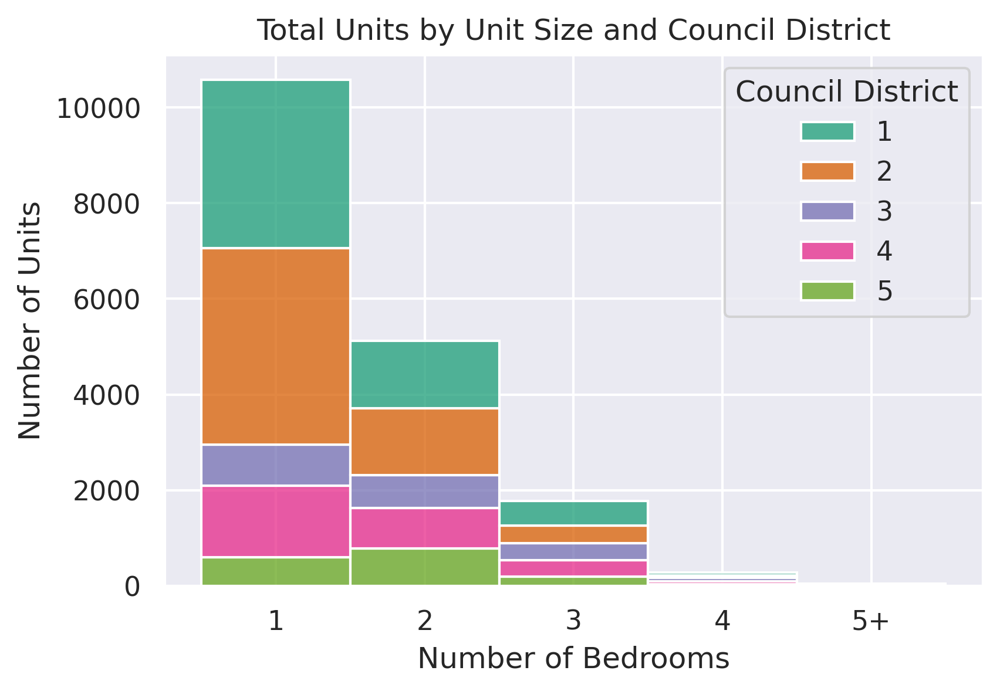

In [5]:
ax = sns.histplot(
    data=gdf.sort_values(by="WARD_str"),
    x='nbrBedRms_grouped',
    hue='WARD_str',
    multiple='stack'
    )
ax.set_title("Total Units by Unit Size and Council District")
ax.set_xlabel("Number of Bedrooms")
ax.set_ylabel("Number of Units")
ax.get_legend().set_title("Council District")

In [6]:
# display the information in a table
tab = pd.crosstab(
    gdf['nbrBedRms_grouped'],
    gdf['WARD_str'],
    margins=True,
    margins_name="Total"
)
tab.index.name = "Number of Bedrooms"
tab.columns.name = "Council District"
tab


Council District,1,2,3,4,5,Total
Number of Bedrooms,,,,,,
1,3526,4101,866,1488,600,10581
2,1414,1395,685,850,781,5125
3,518,361,364,338,196,1777
4,64,45,80,56,38,283
5+,7,18,5,12,10,52
Total,5529,5920,2000,2744,1625,17818


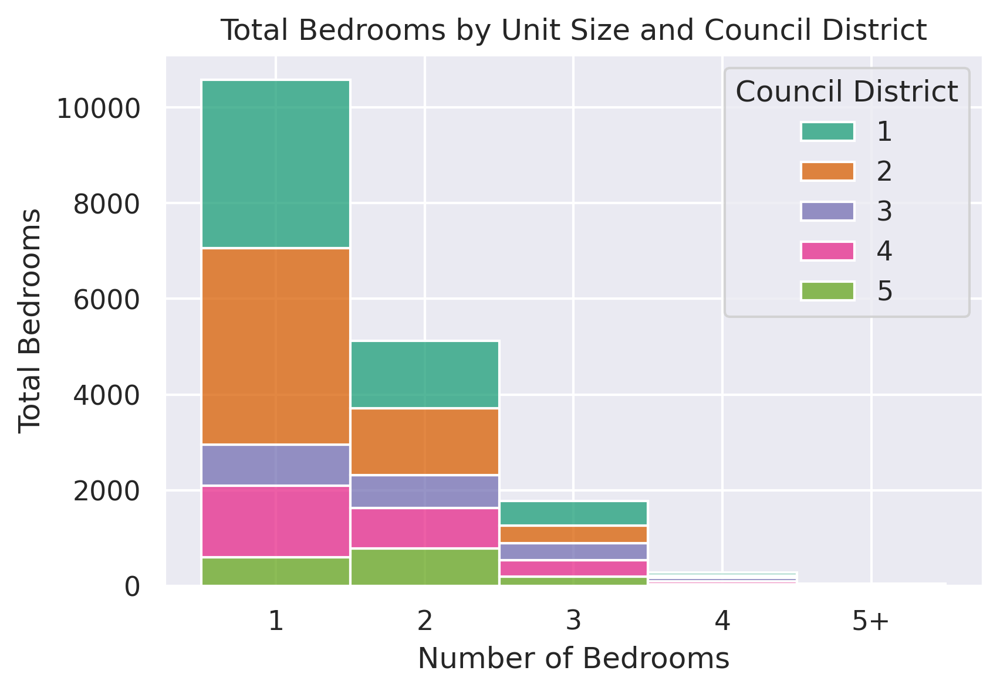

In [7]:
ax = sns.histplot(
    data=gdf.sort_values(by="WARD_str"),
    x='nbrBedRms_grouped',
    hue='WARD_str',
    multiple='stack'
    )
ax.set_title("Total Bedrooms by Unit Size and Council District")
ax.set_xlabel("Number of Bedrooms")
ax.set_ylabel("Total Bedrooms")
ax.get_legend().set_title("Council District")

In [8]:
# display the information in a table
tab = pd.crosstab(
    gdf['nbrBedRms_grouped'],
    gdf['WARD_str'],
    values=gdf['nbrBedRms_studio'],
    aggfunc='sum',
    margins=True,
    margins_name="Total"
)
tab.index.name = "Number of Bedrooms"
tab.columns.name = "Council District"
tab

Council District,1,2,3,4,5,Total
Number of Bedrooms,,,,,,
1,3526,4101,866,1488,600,10581
2,2828,2790,1370,1700,1562,10250
3,1554,1083,1092,1014,588,5331
4,256,180,320,224,152,1132
5+,47,98,26,60,63,294
Total,8211,8252,3674,4486,2965,27588


## Set Up Geospatial Analysis

In [9]:
wards = gpd.read_file("../../municipal-street-list/wards.geojson").to_crs(3857)
wards["NAME"] = wards["NAME"].astype(float)

In [10]:
# gdf.to_file("../data/2023-report-summary.geojson")

In [11]:
quantiles = gdf[~gdf["outlier"]][numerical_columns].quantile([.05, .95])

## Where are the units?

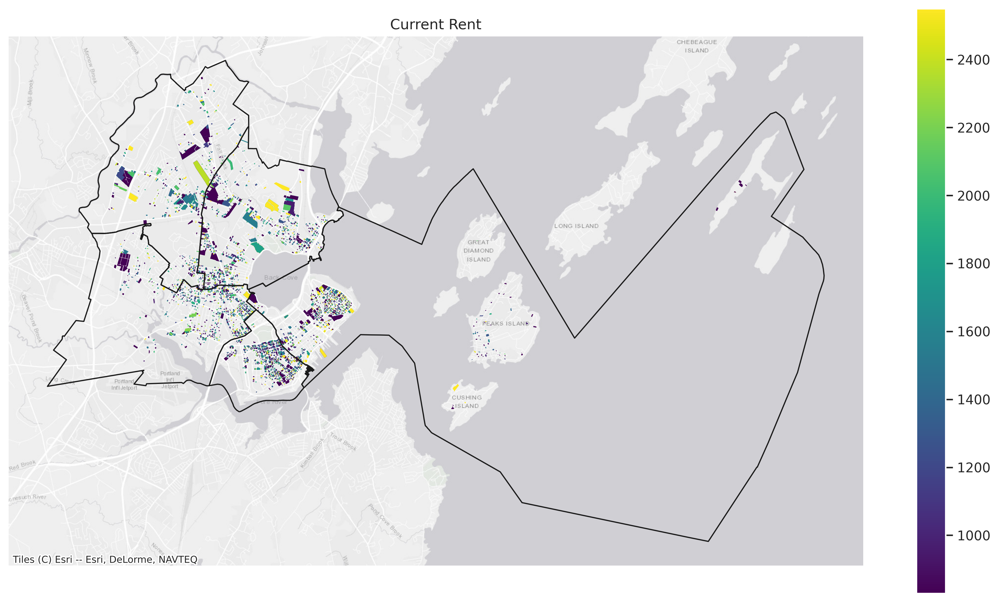

In [12]:
ax = gdf.plot(
    "CurrentRent1", 
    figsize=(16,9), 
    legend=True, 
    cmap="viridis", edgecolor="none",
    vmin=quantiles["CurrentRent1"].iloc[0], 
    vmax=quantiles["CurrentRent1"].iloc[1],)
ax.set_title("Current Rent")
wards.plot(ax=ax, facecolor='none', edgecolor='k')
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

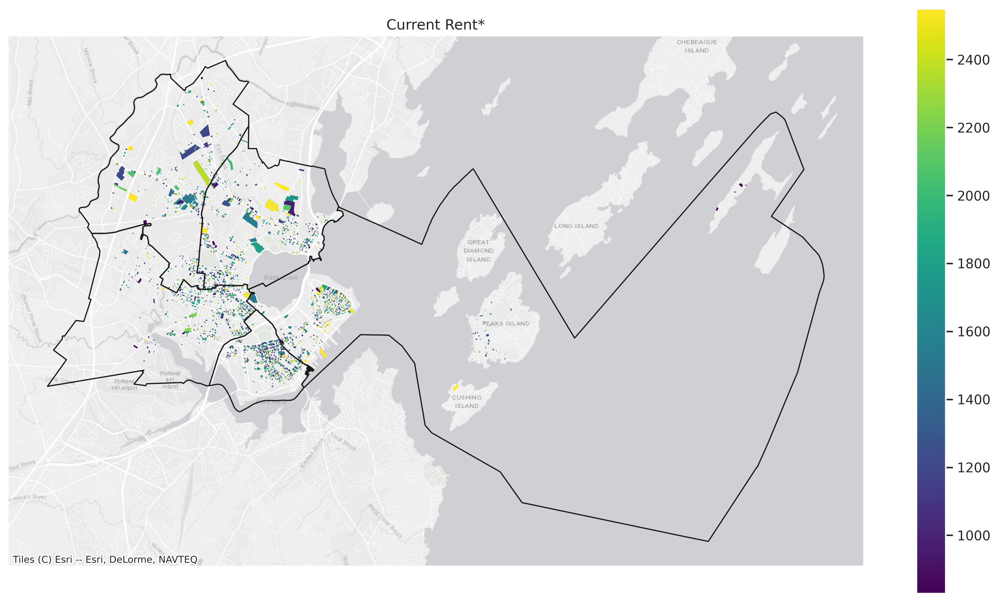

In [13]:
ax = gdf[~gdf["outlier"]].plot(
    "CurrentRent1",
    figsize=(16,9), 
    legend=True, 
    cmap="viridis", edgecolor="none",
    vmin=quantiles["CurrentRent1"].iloc[0], 
    vmax=quantiles["CurrentRent1"].iloc[1]
    )
ax.set_title("Current Rent*")
wards.plot(ax=ax, facecolor='none', edgecolor='k')
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

## Where are the outliers?
Note: Many parcels have more than one unit. The map below marks a parcel as an outlier if any outlier unit is present on that parcel. Only the units that are identified as outliers are excluded from the full report.

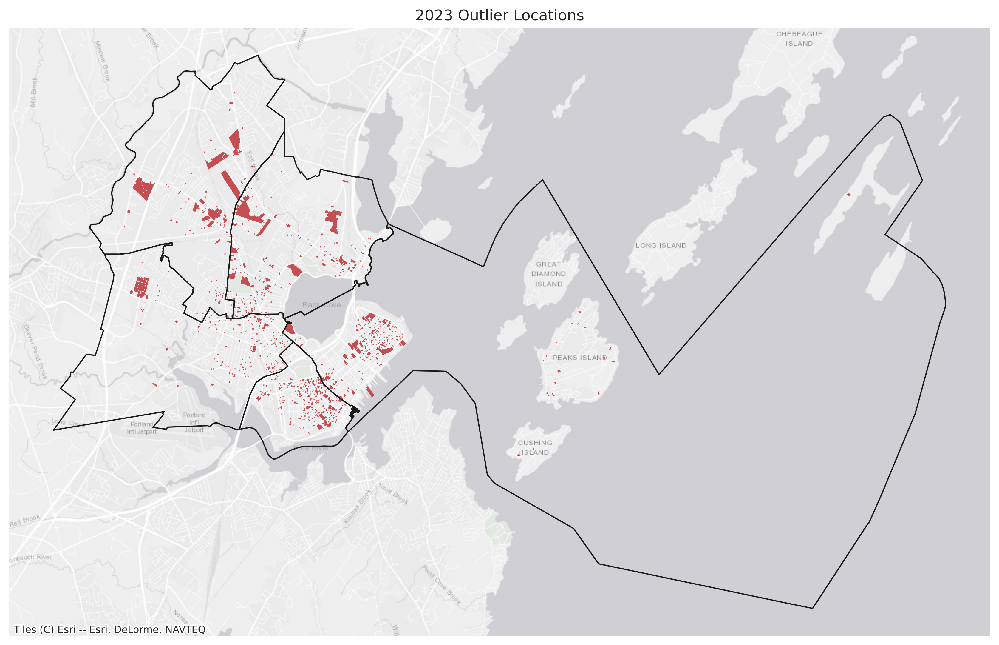

In [14]:
ax = gdf[gdf["outlier"]].plot(color="r", edgecolor='none', figsize=(16,9))
ax.set_title("2023 Outlier Locations")
wards.plot(ax=ax, facecolor='none', edgecolor='k')
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

## Ward Statistics

In [15]:
gdf_mean = wards.merge(gdf[~gdf["outlier"]].groupby("WARD").mean(), left_on="NAME", right_index=True)
gdf_median = wards.merge(gdf[~gdf["outlier"]].groupby("WARD").median(), left_on="NAME", right_index=True)
gdf_sum = wards.merge(gdf.groupby("WARD").sum(), left_on="NAME", right_index=True)

## Maps (Choropleths)

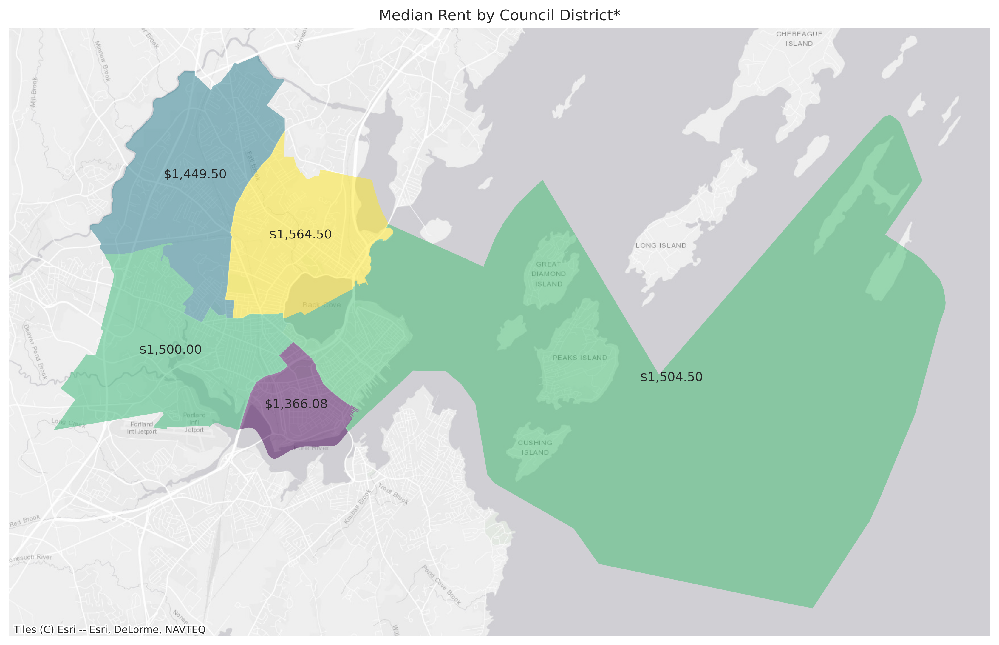

In [16]:
ax = gdf_median.plot("CurrentRent1", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_median.apply(lambda x: ax.annotate(text=f"${x['CurrentRent1']:,.2f}", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Median Rent by Council District*")
ax.axis("off")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)

In [17]:
# median rent by council district
tab = pd.crosstab(
    gdf['nbrBedRms_grouped'],
    gdf['WARD_str'],
    values=gdf['CurrentRent1'],
    aggfunc='median'
)
tab.index.name = "Number of Bedrooms"
tab.columns.name = "Council District"
tab.style.format("${:,.0f}")


Council District,1,2,3,4,5
Number of Bedrooms,,,,,
1,$900,"$1,013",$500,$0,$0
2,"$1,638","$1,500","$1,500","$1,598","$1,417"
3,"$1,950","$1,800","$1,800","$1,782","$1,900"
4,"$2,189","$2,160","$2,400","$2,606","$2,295"
5+,"$2,750","$4,196","$2,400","$1,699","$2,525"


Text(0, 0.5, 'Current Rent')

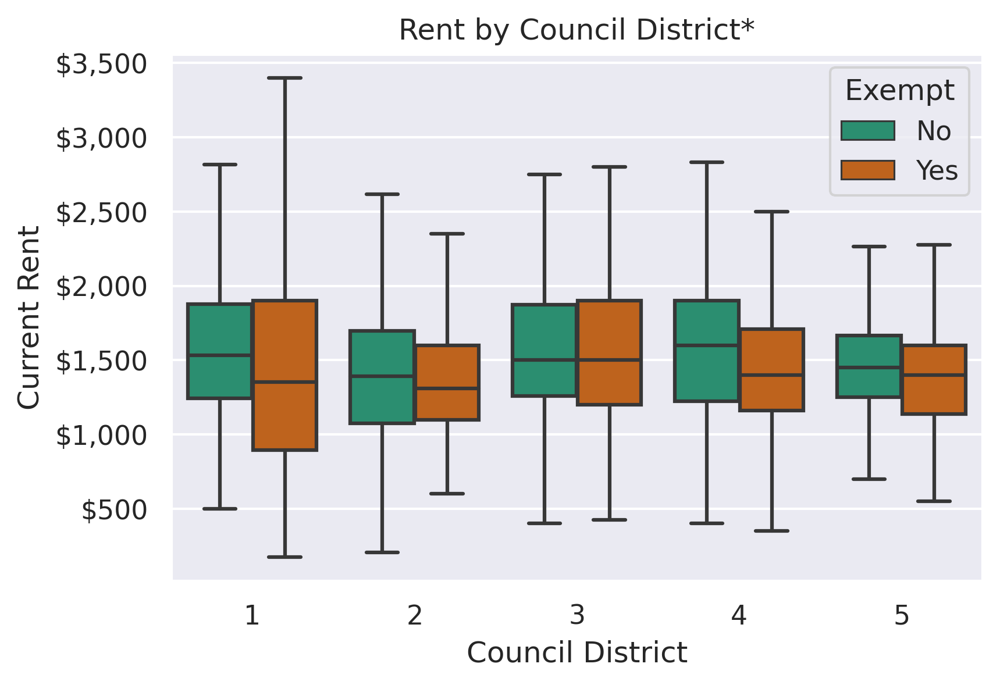

In [18]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"]].sort_values("WARD"),
    x="WARD_str",
    y="CurrentRent1",
    hue="exempt",
    showfliers=False,
    )
ax.set_title("Rent by Council District*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_xaxis().set_label_text("Council District")
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '${:,}'.format(int(x))))
ax.set_ylabel("Current Rent")

In [19]:
# count of units by council district and exempt status
tab = pd.crosstab(
    gdf[~gdf["outlier"]]["WARD_str"],
    gdf[~gdf["outlier"]]["exempt"],
    margins=True,
    margins_name="Total"
)
tab.index.name = "Council District"
tab.columns.name = "Exempt"
tab.columns = ["Not Exempt", "Exempt", "Total"]
tab.style.format("{:,}")


,Not Exempt,Exempt,Total
Council District,,,
1,"2,944",602,"3,546"
2,"3,572",679,"4,251"
3,"1,150",306,"1,456"
4,"1,368",268,"1,636"
5,893,215,"1,108"
Total,"9,927","2,070","11,997"


In [20]:
# median rent by council district and exempt status
tab = pd.crosstab(
    gdf[~gdf["outlier"]]["WARD_str"],
    gdf[~gdf["outlier"]]["exempt"],
    values=gdf[~gdf["outlier"]]["CurrentRent1"],
    aggfunc='median'
)
tab.index.name = "Council District"
tab.columns.name = "Exempt"
tab.columns = ["Not Exempt", "Exempt"]
tab.style.format("${:,.0f}")

,Not Exempt,Exempt
Council District,,
1,"$1,534","$1,351"
2,"$1,394","$1,311"
3,"$1,500","$1,500"
4,"$1,600","$1,400"
5,"$1,450","$1,400"


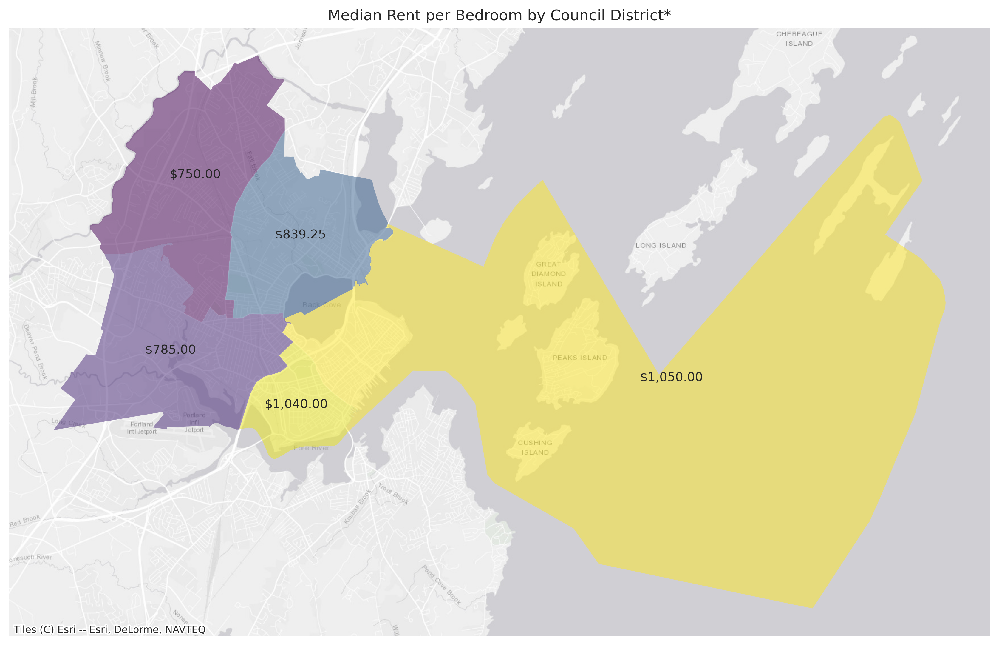

In [21]:
ax = gdf_median.plot("Rent_per_BedRms", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_median.apply(lambda x: ax.annotate(text=f"${x['Rent_per_BedRms']:,.2f}", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Median Rent per Bedroom by Council District*")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

In [22]:
tab = pd.crosstab(
    gdf[~gdf["outlier"]]["WARD_str"],
    gdf[~gdf["outlier"]]["nbrBedRms_grouped"],
    values=gdf[~gdf["outlier"]]["CurrentRent1"],
    aggfunc='median',
    margins=True,
    margins_name="Total"
)
tab.index.name = "Council District"
tab.columns.name = "Number of Bedrooms"
tab.style.format("${:,.0f}")

Number of Bedrooms,1,2,3,4,5+,Total
Council District,,,,,,
1,"$1,318","$1,700","$2,090","$2,420","$2,750","$1,504"
2,"$1,235","$1,595","$1,877","$2,284","$4,196","$1,366"
3,"$1,260","$1,520","$1,853","$2,400","$2,400","$1,500"
4,"$1,228","$1,601","$1,837","$2,654","$1,699","$1,564"
5,"$1,200","$1,450","$1,984","$2,260","$3,200","$1,450"
Total,"$1,255","$1,580","$1,900","$2,400","$2,750","$1,460"


Text(0.5, 0, 'Council District')

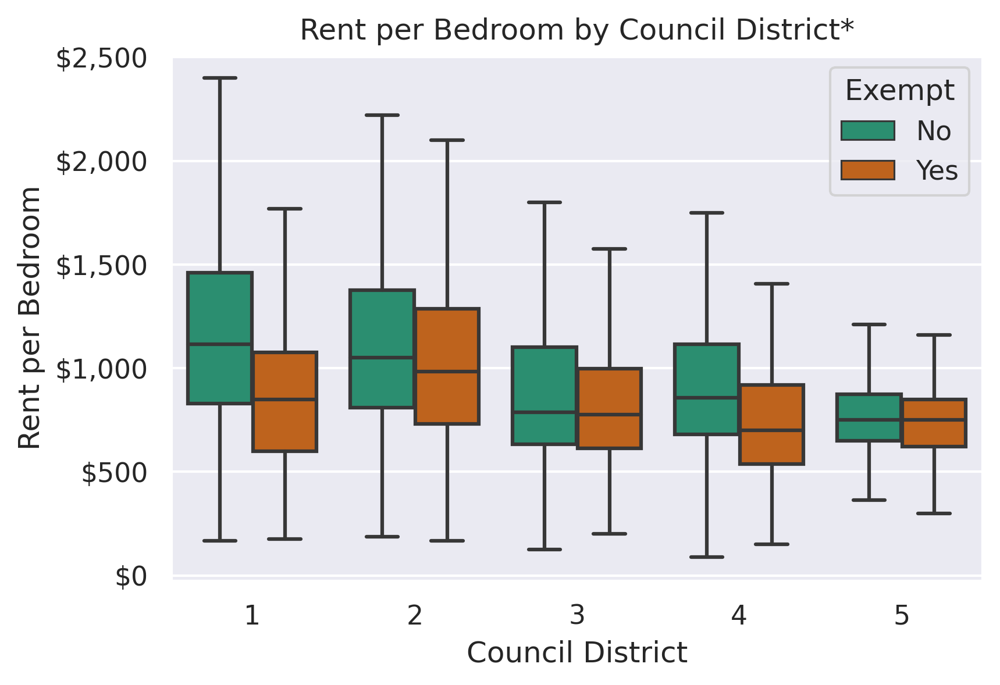

In [23]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"]].sort_values("WARD"),
    x="WARD_str",
    y="Rent_per_BedRms",
    hue="exempt",
    showfliers=False,
    )
ax.set_title("Rent per Bedroom by Council District*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '${:,}'.format(int(x))))
ax.set_ylabel("Rent per Bedroom")
ax.set_xlabel("Council District")

In [24]:
tab = pd.crosstab(
    gdf[~gdf["outlier"]]["WARD_str"],
    gdf[~gdf["outlier"]]["nbrBedRms_grouped"],
    values=gdf[~gdf["outlier"]]["Rent_per_BedRms"],
    aggfunc='median',
    margins=True,
    margins_name="Total"
)
tab.index.name = "Council District"
tab.columns.name = "Number of Bedrooms"
tab.style.format("${:,.0f}")

Number of Bedrooms,1,2,3,4,5+,Total
Council District,,,,,,
1,"$1,318",$850,$697,$605,$344,"$1,050"
2,"$1,235",$798,$626,$571,$799,"$1,040"
3,"$1,260",$760,$618,$600,$480,$785
4,"$1,228",$800,$612,$664,$340,$839
5,"$1,200",$725,$661,$565,$425,$750
Total,"$1,255",$790,$633,$600,$480,$935


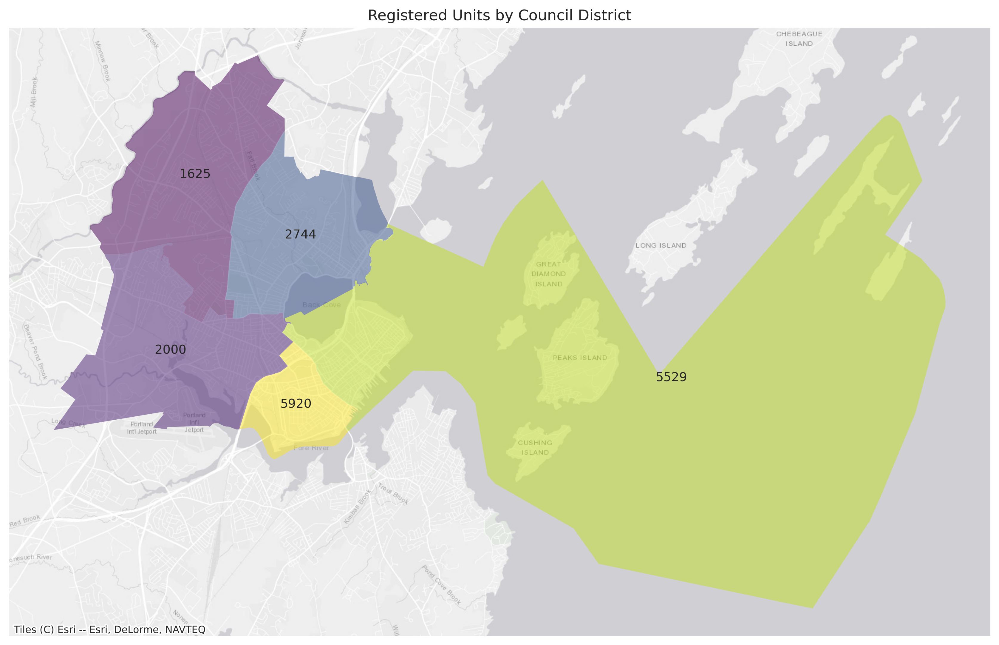

In [25]:
ax = gdf_sum.plot("Count", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_sum.apply(lambda x: ax.annotate(text=x['Count'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Registered Units by Council District")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

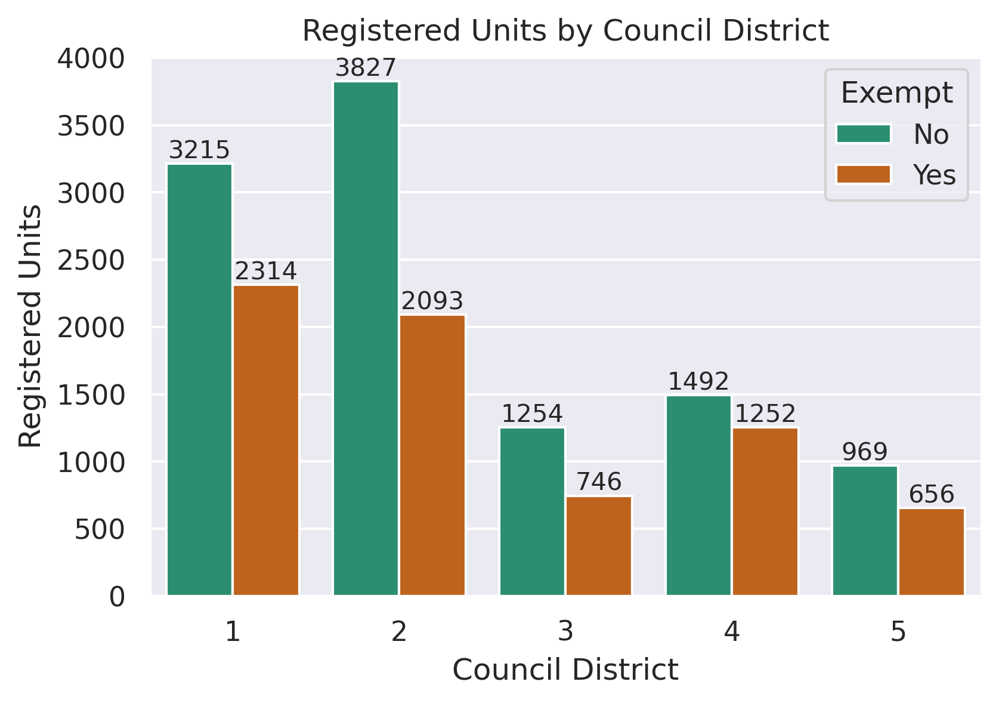

In [26]:
ax = sns.barplot(
    data=gdf.sort_values("WARD"),
    x="WARD_str",
    y="Count",
    hue="exempt",
    estimator=np.sum
    )
ax.set_title("Registered Units by Council District")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.set_xlabel("Council District")
ax.set_ylabel("Registered Units")
for bars in ax.containers:
    ax.bar_label(
        bars,
        fmt='%d',
        label_type='edge'
        )

In [27]:
# Number of units by council district
tab = pd.crosstab(
    gdf["WARD_str"],
    gdf["nbrBedRms_grouped"],
    values=gdf["Count"],
    aggfunc='sum',
    margins=True,
    margins_name="Total"
)
tab.index.name = "Council District"
tab.columns.name = "Number of Units"
tab.style.format("{:,.0f}")
tab

Number of Units,1,2,3,4,5+,Total
Council District,,,,,,
1,3526,1414,518,64,7,5529
2,4101,1395,361,45,18,5920
3,866,685,364,80,5,2000
4,1488,850,338,56,12,2744
5,600,781,196,38,10,1625
Total,10581,5125,1777,283,52,17818


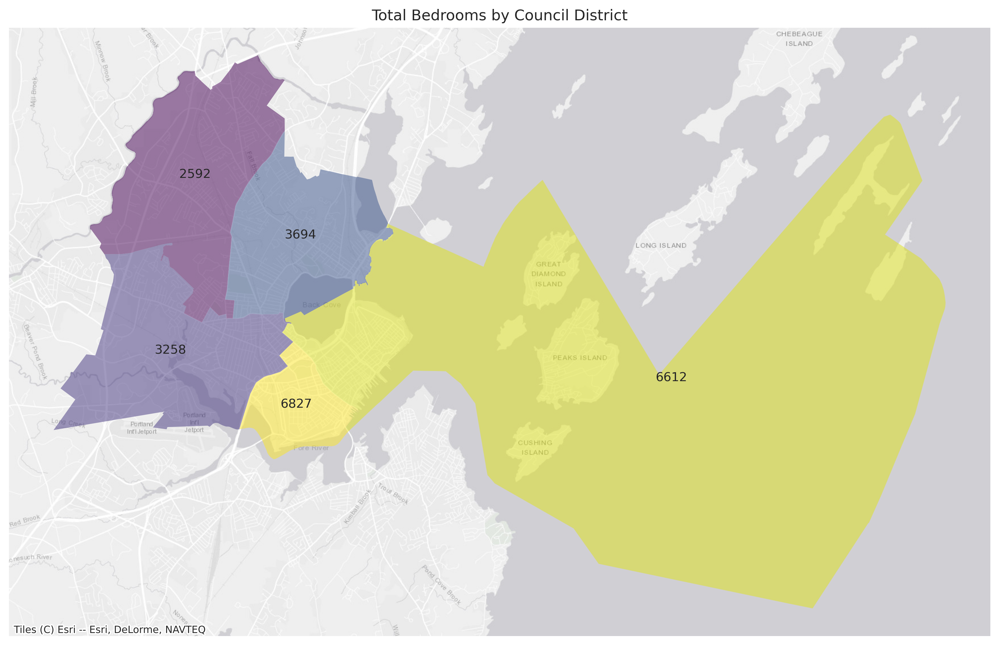

In [28]:
ax = gdf_sum.plot("nbrBedRms1",cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_sum.apply(lambda x: ax.annotate(text=x['nbrBedRms1'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Total Bedrooms by Council District")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

In [29]:
# number of bedrooms by council district
tab = pd.crosstab(
    gdf["WARD_str"],
    gdf["nbrBedRms_grouped"],
    values=gdf["nbrBedRms_studio"],
    aggfunc='sum',
    margins=True,
    margins_name="Total"
)
tab.index.name = "Council District"
tab.columns.name = "Number of Bedrooms"
tab.style.format("{:,.0f}")
tab

Number of Bedrooms,1,2,3,4,5+,Total
Council District,,,,,,
1,3526,2828,1554,256,47,8211
2,4101,2790,1083,180,98,8252
3,866,1370,1092,320,26,3674
4,1488,1700,1014,224,60,4486
5,600,1562,588,152,63,2965
Total,10581,10250,5331,1132,294,27588


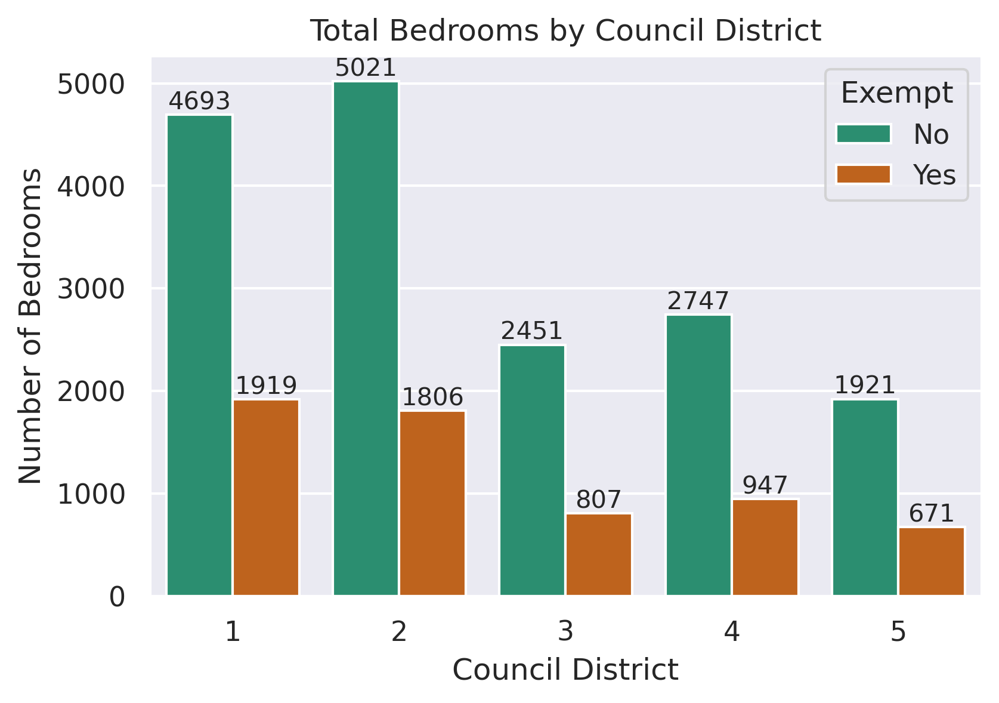

In [30]:
ax = sns.barplot(
    data=gdf.sort_values("WARD"),
    x="WARD_str",
    y="nbrBedRms1",
    hue="exempt",
    estimator=np.sum,
    errorbar=None
    )
ax.set_title("Total Bedrooms by Council District")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.set_xlabel("Council District")
ax.set_ylabel("Number of Bedrooms")
for bars in ax.containers:
    ax.bar_label(
        bars,
        fmt='%d',
        label_type='edge'
        )

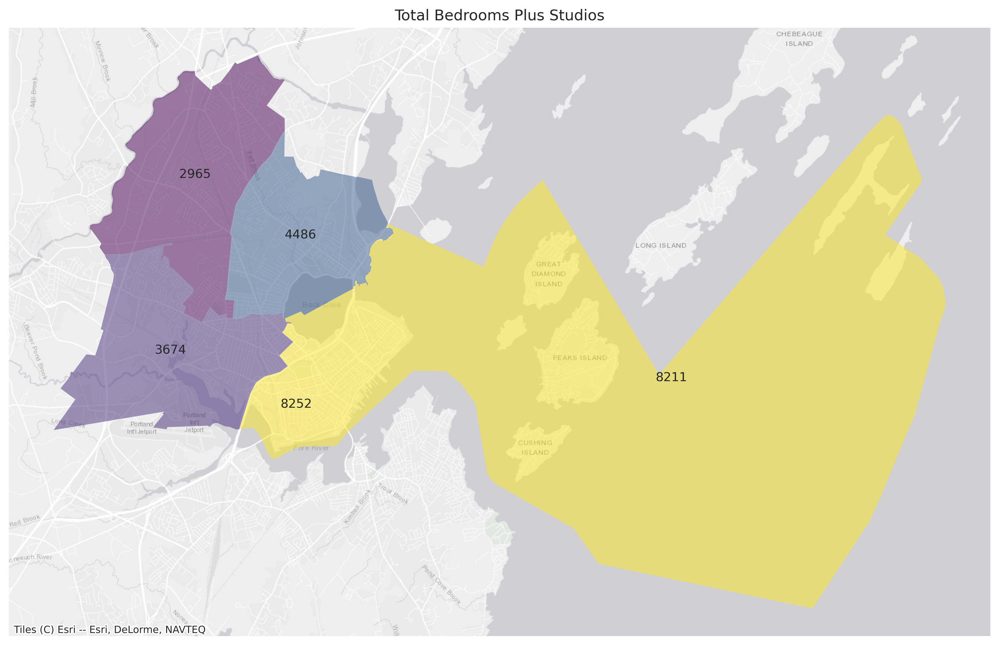

In [31]:
ax = gdf_sum.plot("nbrBedRms_studio", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_sum.apply(lambda x: ax.annotate(text=x['nbrBedRms_studio'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Total Bedrooms Plus Studios")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

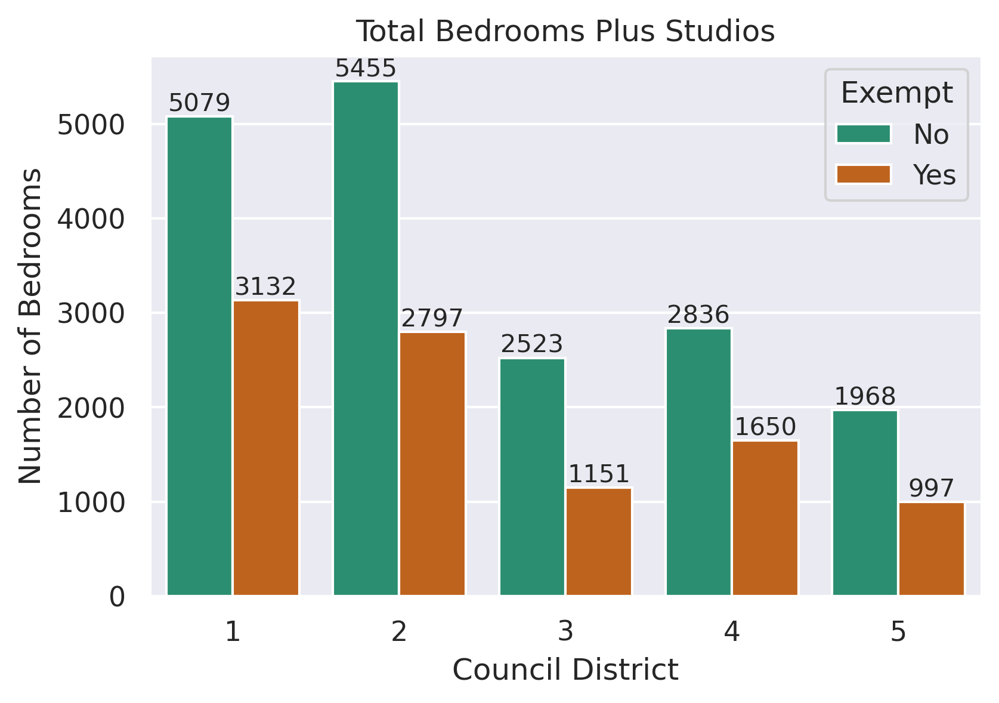

In [32]:
ax = sns.barplot(
    data=gdf.sort_values("WARD"),
    x="WARD_str",
    y="nbrBedRms_studio",
    hue="exempt",
    estimator=np.sum,
    errorbar=None
    )
ax.set_title("Total Bedrooms Plus Studios")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.set_xlabel("Council District")
ax.set_ylabel("Number of Bedrooms")
for bars in ax.containers:
    ax.bar_label(
        bars,
        fmt='%d',
        label_type='edge'
        )

In [33]:
# total bedrooms plus studios per council district
tab = pd.crosstab(
    gdf["WARD_str"],
    gdf["nbrBedRms_grouped"],
    values=gdf["nbrBedRms_studio"],
    aggfunc='sum',
    margins=True,
    margins_name="Total"
)
tab.index.name = "Council District"
tab.columns.name = "Number of Bedrooms (plus studios)"
tab.style.format("{:,.0f}")
tab

Number of Bedrooms (plus studios),1,2,3,4,5+,Total
Council District,,,,,,
1,3526,2828,1554,256,47,8211
2,4101,2790,1083,180,98,8252
3,866,1370,1092,320,26,3674
4,1488,1700,1014,224,60,4486
5,600,1562,588,152,63,2965
Total,10581,10250,5331,1132,294,27588


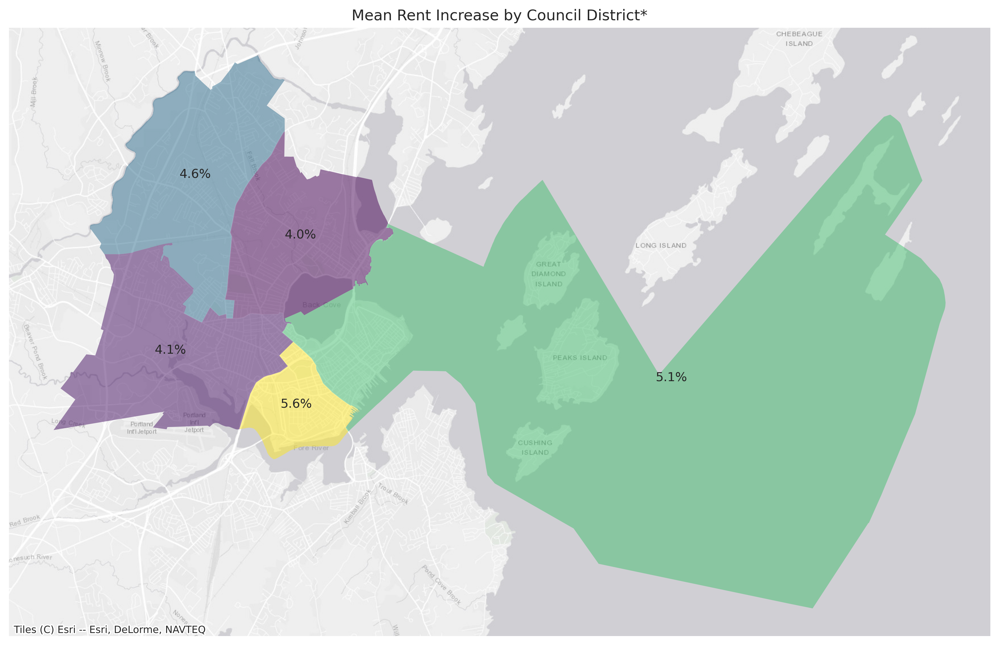

In [34]:
ax = gdf_mean.plot("Rent_Inc_percent", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_mean.apply(lambda x: ax.annotate(text=f"{x['Rent_Inc_percent']:.1f}%", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Mean Rent Increase by Council District*")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

Text(0.5, 0, 'Council District')

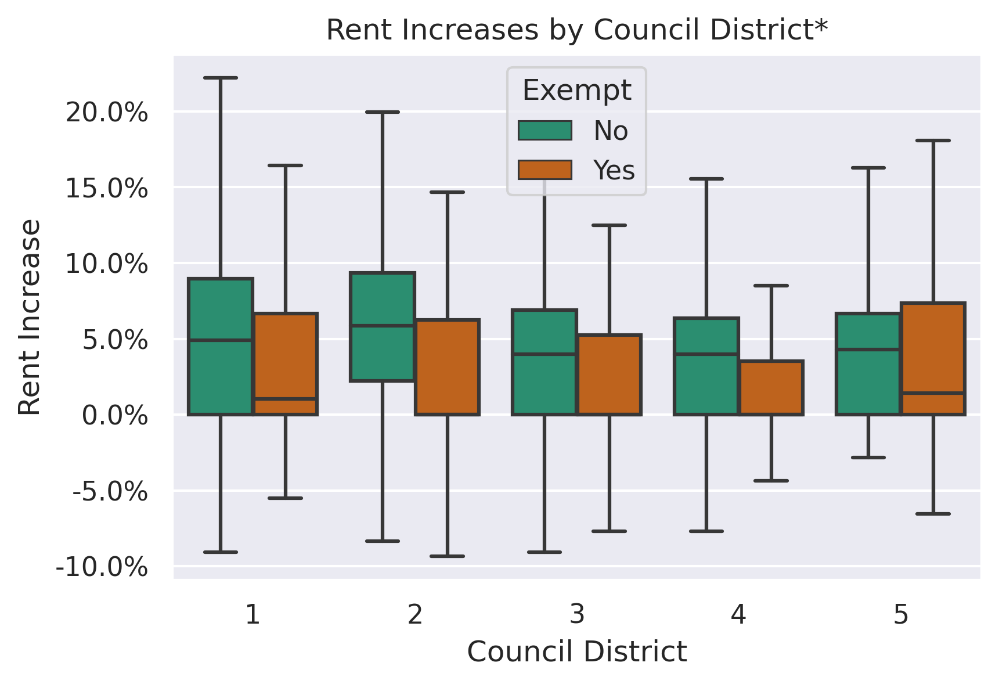

In [35]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"]].sort_values("WARD"),
    x="WARD_str",
    y="Rent_Inc_percent",
    hue="exempt",
    showfliers=False
    )
ax.set_title("Rent Increases by Council District*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '{:.1f}%'.format(int(x))))
ax.set_ylabel("Rent Increase")
ax.set_xlabel("Council District")


In [36]:
# median rent increase by council district
tab = pd.crosstab(
    gdf[~gdf["outlier"]]["WARD_str"],
    gdf[~gdf["outlier"]]["exempt"],
    values=gdf[~gdf["outlier"]]["Rent_Inc_percent"],
    aggfunc='mean',
)
tab.index.name = "Council District"
tab.columns.name = "Exempt"
tab.columns = ["Not Exempt", "Exempt"]
tab.style.format("{:,.1f}%")

,Not Exempt,Exempt
Council District,,
1,5.2%,4.3%
2,5.9%,3.9%
3,4.2%,3.7%
4,4.2%,3.1%
5,4.5%,4.7%


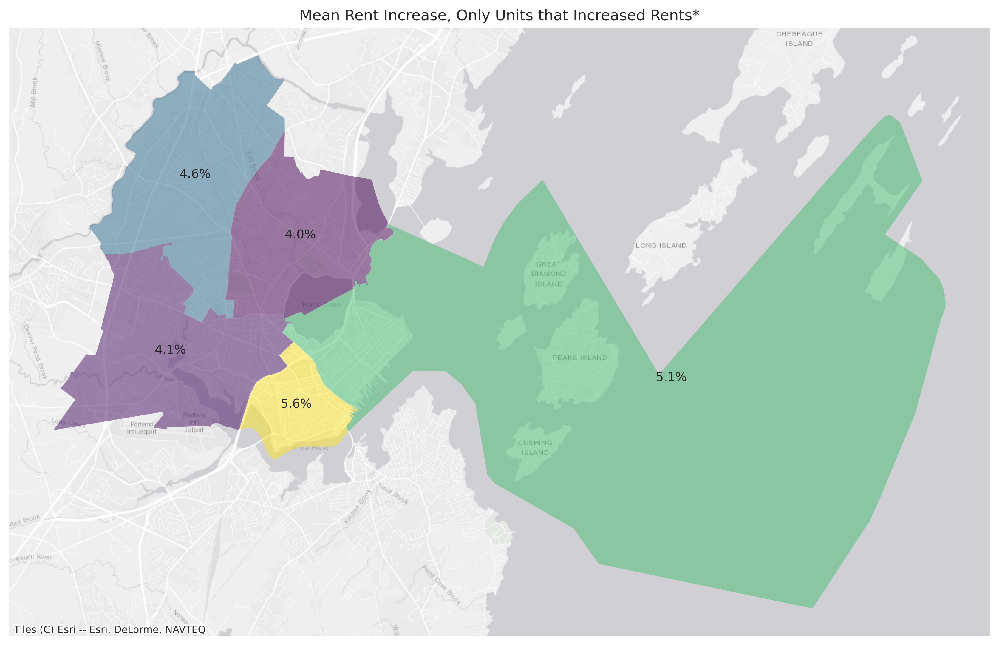

In [37]:
ax = gdf_mean.plot("Rent_Inc_percent", cmap="viridis", edgecolor="none", figsize=(16,9), alpha=0.5)
gdf_mean.apply(lambda x: ax.annotate(text=f"{x['Rent_Inc_percent']:.1f}%", xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
ax.set_title("Mean Rent Increase, Only Units that Increased Rents*")
cx.add_basemap(ax, source=cx.providers.Esri.WorldGrayCanvas)
ax.axis('off');

Text(0.5, 0, 'Council District')

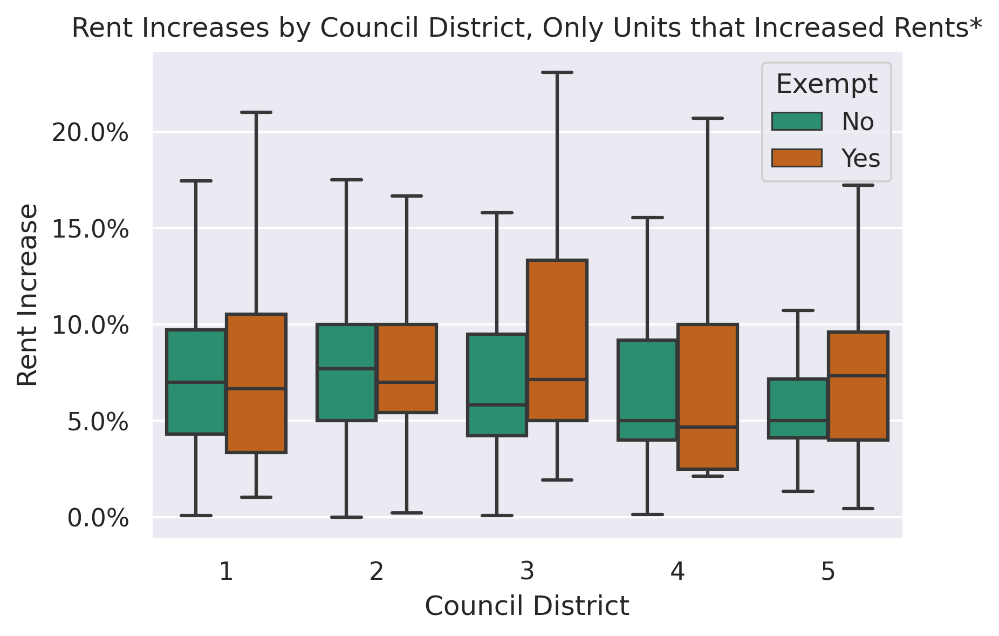

In [38]:
ax = sns.boxplot(
    data=gdf[~gdf["outlier"] & (gdf["Rent_Inc"] > 0)].sort_values("WARD"),
    x="WARD_str",
    y="Rent_Inc_percent",
    hue="exempt",
    showfliers=False
    )
ax.set_title("Rent Increases by Council District, Only Units that Increased Rents*")
handles, labels = ax.get_legend_handles_labels()
ax.legend(title="Exempt", handles=handles, labels=["No", "Yes"])
ax.get_yaxis().set_major_formatter(mpl.ticker.FuncFormatter(lambda x, p: '{:.1f}%'.format(int(x))))
ax.set_ylabel("Rent Increase")
ax.set_xlabel("Council District")

In [39]:
# median rent increase by council district, only units that increased rents
tab = pd.crosstab(
    gdf[~gdf["outlier"] & (gdf["Rent_Inc"] > 0)]["WARD_str"],
    gdf[~gdf["outlier"] & (gdf["Rent_Inc"] > 0)]["exempt"],
    values=gdf[~gdf["outlier"] & (gdf["Rent_Inc"] > 0)]["Rent_Inc_percent"],
    aggfunc='mean',
)
tab.index.name = "Council District"
tab.columns.name = "Exempt"
tab.columns = ["Not Exempt", "Exempt"]
tab.style.format("{:,.1f}%")

,Not Exempt,Exempt
Council District,,
1,7.2%,8.7%
2,7.8%,9.1%
3,7.0%,10.6%
4,6.6%,8.4%
5,6.3%,8.6%
